In [1]:
pip install roboflow

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 80.3/80.3 kB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 4.6 MB/s eta 0:00:00
  Attempting uninstall: idna
    Found existing installation: idna 3.8
    Uninstalling idna-3.8:
      Successfully uninstalled idna-3.8


In [2]:
from roboflow import Roboflow
rf = Roboflow(api_key="UikkgxL5xfyaBV2AZdZh")
project = rf.workspace("bidex-bq2i7").project("dog-breeds-8kwtm")
version = project.version(1)
dataset = version.download("yolov5")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Dog-Breeds-1 in yolov5pytorch:: 100%|██████████| 14027/14027 [00:02<00:00, 5307.54it/s]


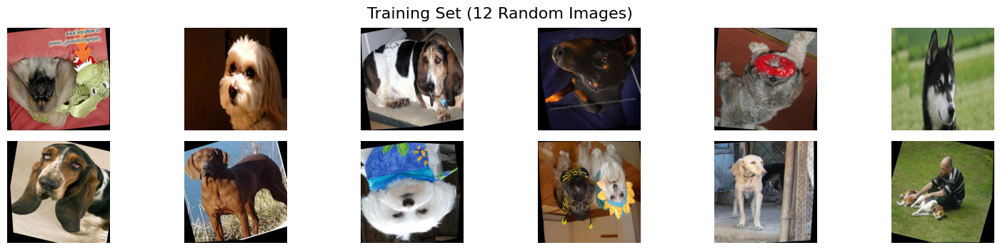

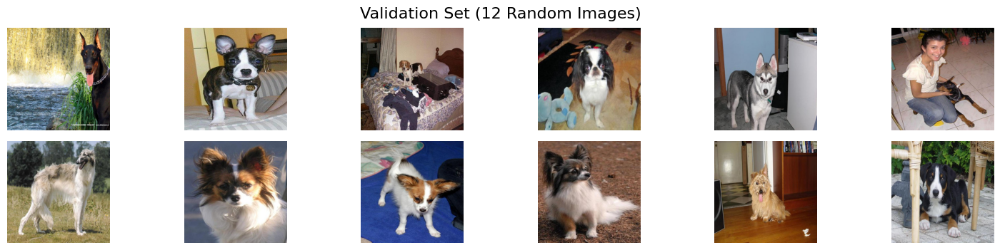

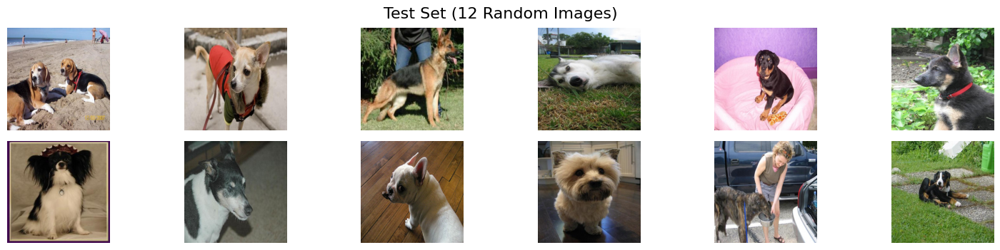

In [3]:
import os
import random
import matplotlib.pyplot as plt
import cv2

# Function to display 12 images from a folder
def display_images_from_folder(folder_path, title):
    image_files = [os.path.join(folder_path, f) for f in os.listdir(folder_path) if f.endswith(('.png', '.jpg', '.jpeg'))]
    random_images = random.sample(image_files, 12)  # Pick 12 random images

    plt.figure(figsize=(15,10))
    plt.suptitle(title, fontsize=16)

    for idx, image_file in enumerate(random_images):
        img = cv2.imread(image_file)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB for displaying

        plt.subplot(6, 6, idx + 1)
        plt.imshow(img)
        plt.axis('off')

    plt.tight_layout()
    plt.show()

# Paths to your datasets
train_folder = '/content/Dog-Breeds-1/train/images'
valid_folder = '/content/Dog-Breeds-1/valid/images'
test_folder = '/content/Dog-Breeds-1/test/images'

# Display images
display_images_from_folder(train_folder, "Training Set (12 Random Images)")
display_images_from_folder(valid_folder, "Validation Set (12 Random Images)")
display_images_from_folder(test_folder, "Test Set (12 Random Images)")


In [4]:
!git clone https://github.com/ultralytics/yolov5.git

Cloning into 'yolov5'...
remote: Enumerating objects: 16954, done.
remote: Counting objects: 100% (149/149), done.
remote: Compressing objects: 100% (104/104), done.
remote: Total 16954 (delta 76), reused 95 (delta 45), pack-reused 16805 (from 1)
Receiving objects: 100% (16954/16954), 15.71 MiB | 14.68 MiB/s, done.
Resolving deltas: 100% (11609/11609), done.


In [5]:
%cd yolov5
!pip install -r requirements.txt

/content/yolov5
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 19.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 105.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 872.8/872.8 kB 52.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 5.3 MB/s eta 0:00:00
  Attempting uninstall: pillow
    Found existing installation: Pillow 9.4.0
    Uninstalling Pillow-9.4.0:
      Successfully uninstalled Pillow-9.4.0


In [1]:
dataset_path = "/content/Dog-Breeds-1"

In [2]:
!python /content/yolov5/train.py --img 640 --batch 16 --epochs 50 --data /content/Dog-Breeds-1/data.yaml --weights yolov5s.pt --cache

Streaming output truncated to the last 5000 lines.
      43/49       4.4G    0.01832    0.01238      0.021         45        640:  77% 304/396 [01:35<00:35,  2.57it/s]/content/yolov5/train.py:412: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(amp):
      43/49       4.4G     0.0183    0.01238    0.02101         46        640:  77% 305/396 [01:35<00:35,  2.58it/s]/content/yolov5/train.py:412: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(amp):
      43/49       4.4G    0.01828    0.01239    0.02101         51        640:  77% 306/396 [01:36<00:33,  2.71it/s]/content/yolov5/train.py:412: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(amp):
      43/49       4.4G    0.018

In [3]:
%load_ext tensorboard
%tensorboard --logdir /content/yolov5/runs/train

<IPython.core.display.Javascript object>

In [4]:
!python /content/yolov5/detect.py --weights /content/yolov5/runs/train/exp/weights/best.pt --img-size 640 --conf-thres 0.3 --source /content/Dog-Breeds-1/test/images --project /content/Dog-Breeds-1/results --name detect_results --save-txt --save-crop


detect: weights=['/content/yolov5/runs/train/exp/weights/best.pt'], source=/content/Dog-Breeds-1/test/images, data=yolov5/data/coco128.yaml, imgsz=[640, 640], conf_thres=0.3, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_format=0, save_csv=False, save_conf=False, save_crop=True, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=/content/Dog-Breeds-1/results, name=detect_results, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-366-gf7322921 Python-3.10.12 torch-2.4.0+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7064065 parameters, 0 gradients, 15.9 GFLOPs
image 1/225 /content/Dog-Breeds-1/test/images/n02085620_1502_jpg.rf.14c50ad5defa239219727bac27573c79.jpg: 640x640 (no detections), 11.6ms
image 2/225 /content/Dog-Breeds-1/test/images/n02085620_1816_jpg.rf.a9fbd95a3284ef55ec0e36f6a798506b.jpg: 640x640

In [5]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

def load_results(results_dir):
    images = []
    labels = []
    for img_name in os.listdir(results_dir):
        if img_name.endswith('.jpg'):
            img_path = os.path.join(results_dir + "/crops", img_name)
            img = cv2.imread(img_path)
            images.append(img)

            # Load the detection results
            txt_path = os.path.join(results_dir + "/labels", img_name.replace('.jpg', '.txt'))
            if os.path.exists(txt_path):
                with open(txt_path, 'r') as file:
                    lines = file.readlines()
                    img_labels = []
                    for line in lines:
                        parts = line.strip().split()
                        class_id = int(parts[0])
                        confidence = float(parts[1])
                        breed_label = f'Breed {class_id}'  # Replace with actual label mapping
                        img_labels.append((breed_label, confidence))
                    labels.append(img_labels)
    return images, labels

def visualize_results(images, labels):
    for img, img_labels in zip(images, labels):
        for label, confidence in img_labels:
            # Add labels and confidence to the image
            cv2.putText(img, f'{label}: {confidence:.2f}', (10, 30 + 30 * img_labels.index((label, confidence))),
                        cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2, cv2.LINE_AA)
        plt.figure(figsize=(10, 10))
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.show()

results_dir = "/content/Dog-Breeds-1/results"
images, labels = load_results(results_dir)
visualize_results(images, labels)


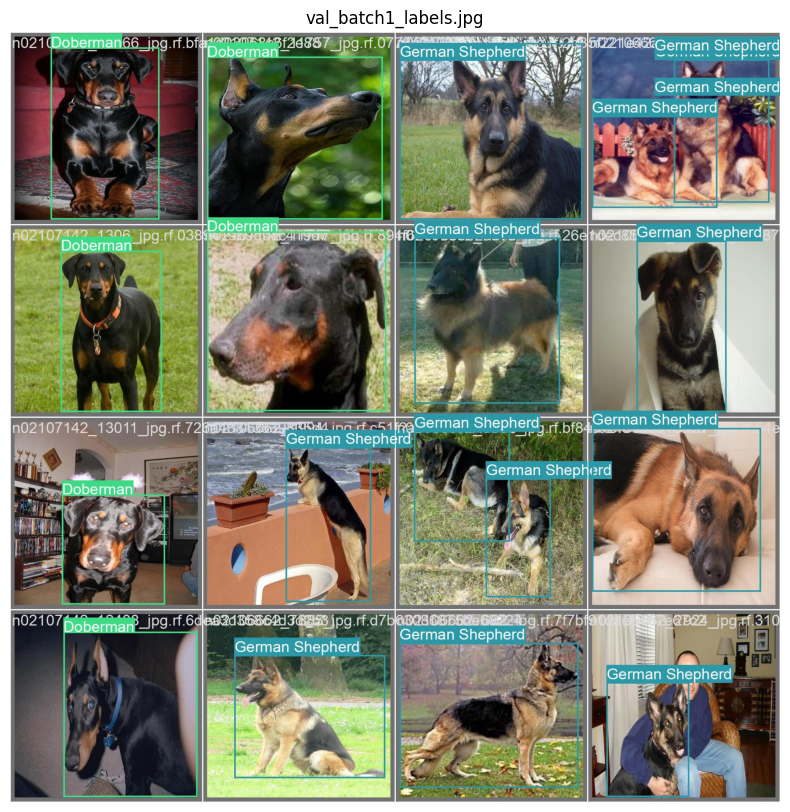

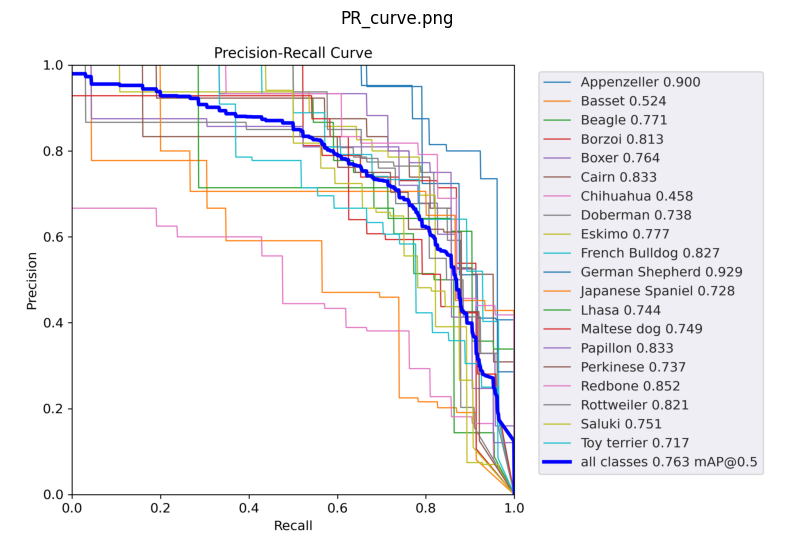

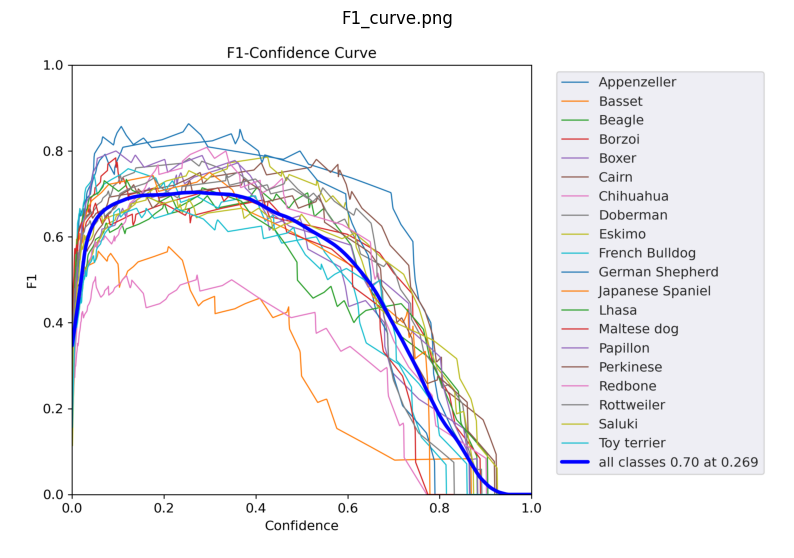

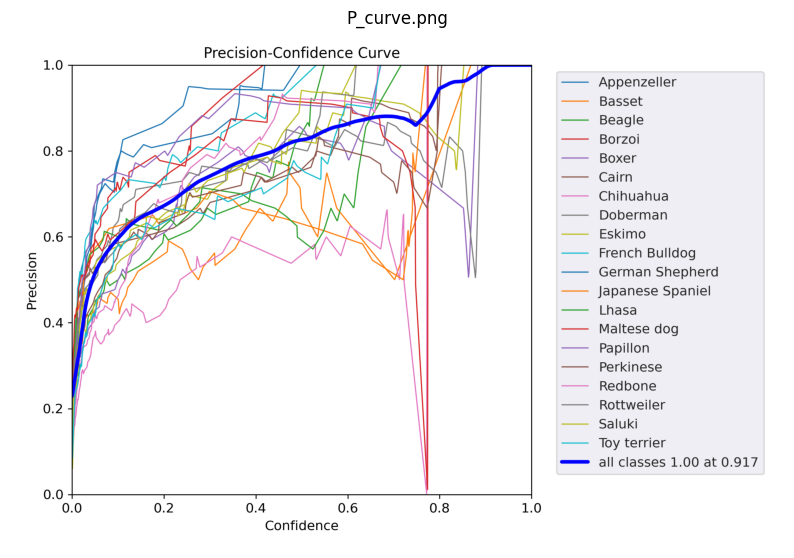

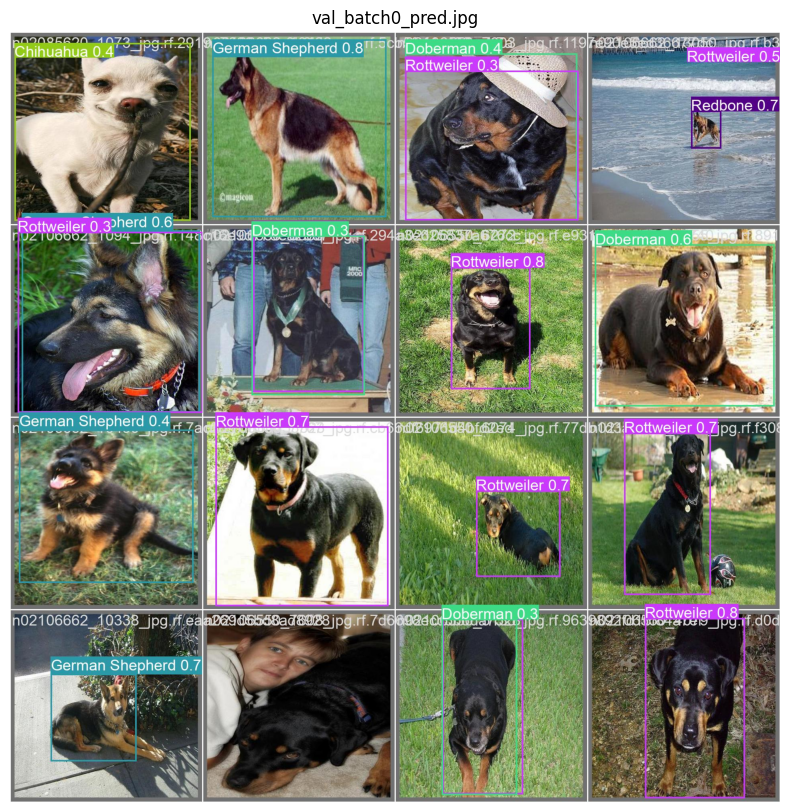

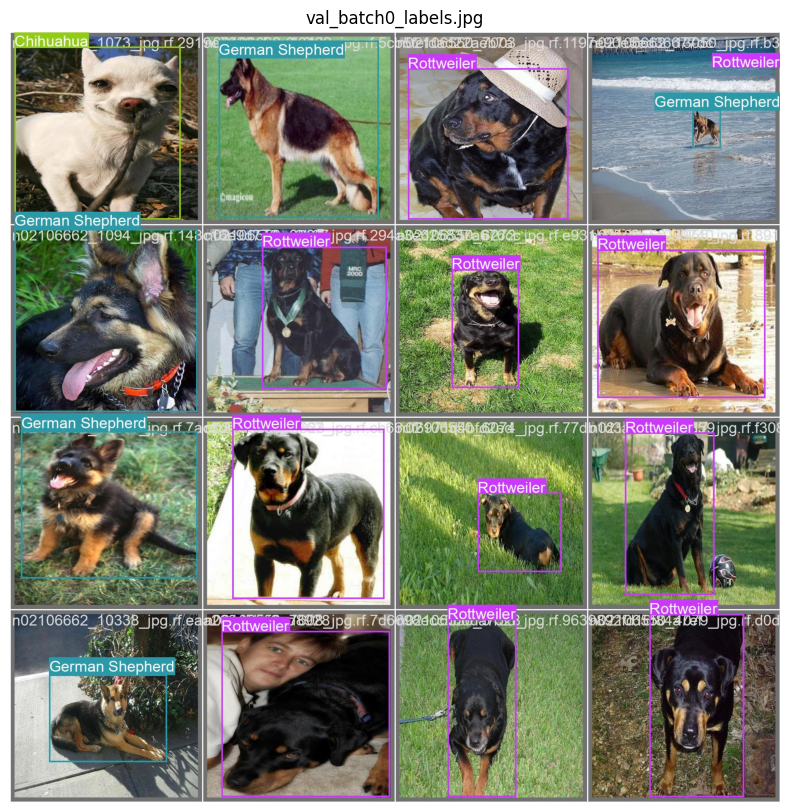

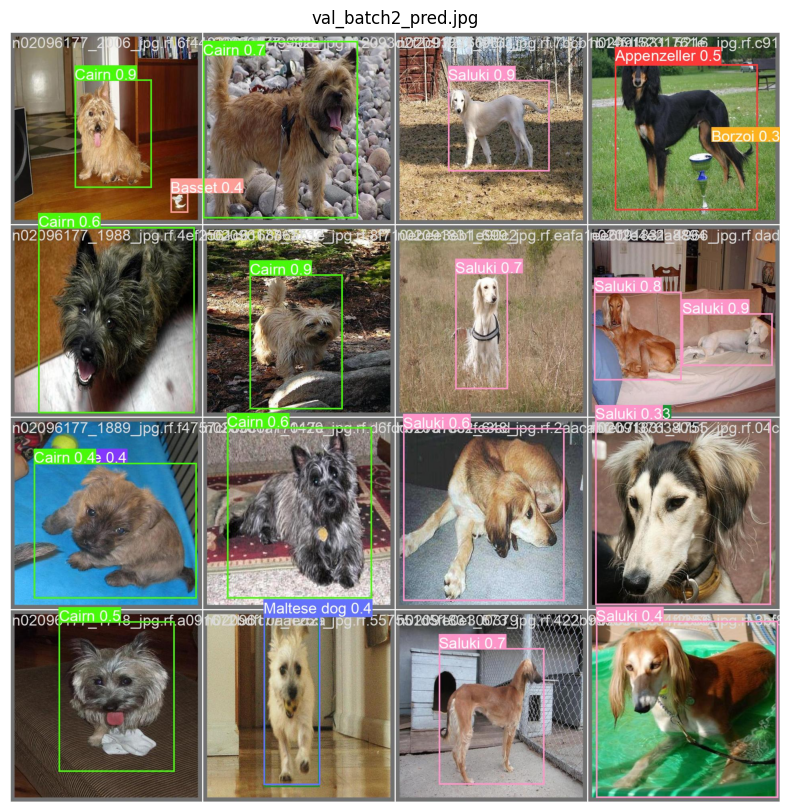

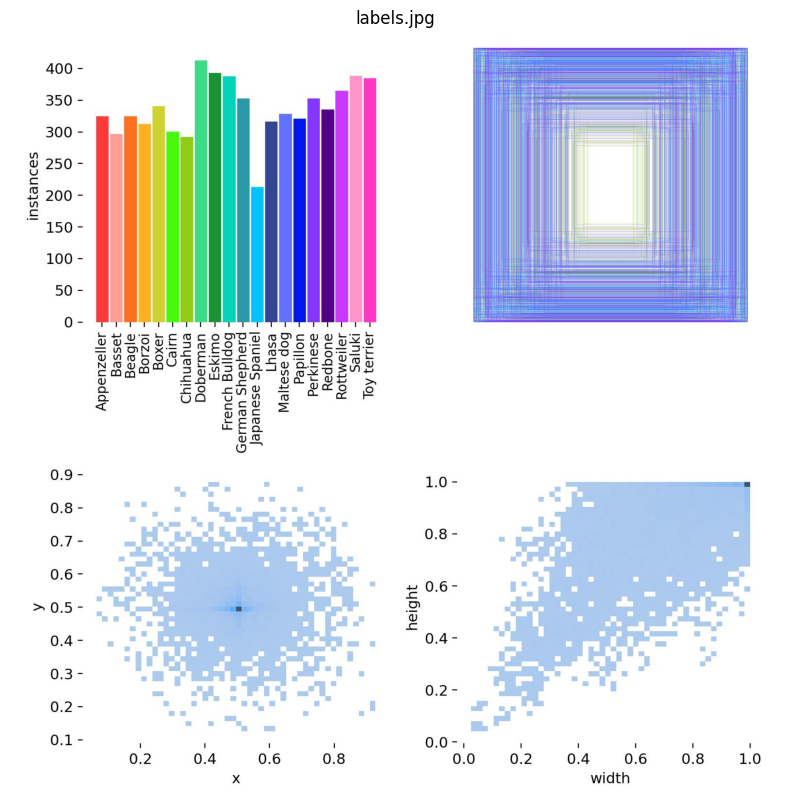

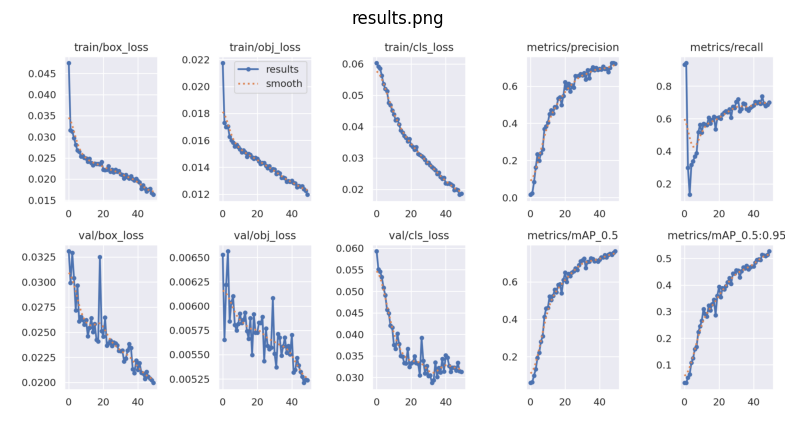

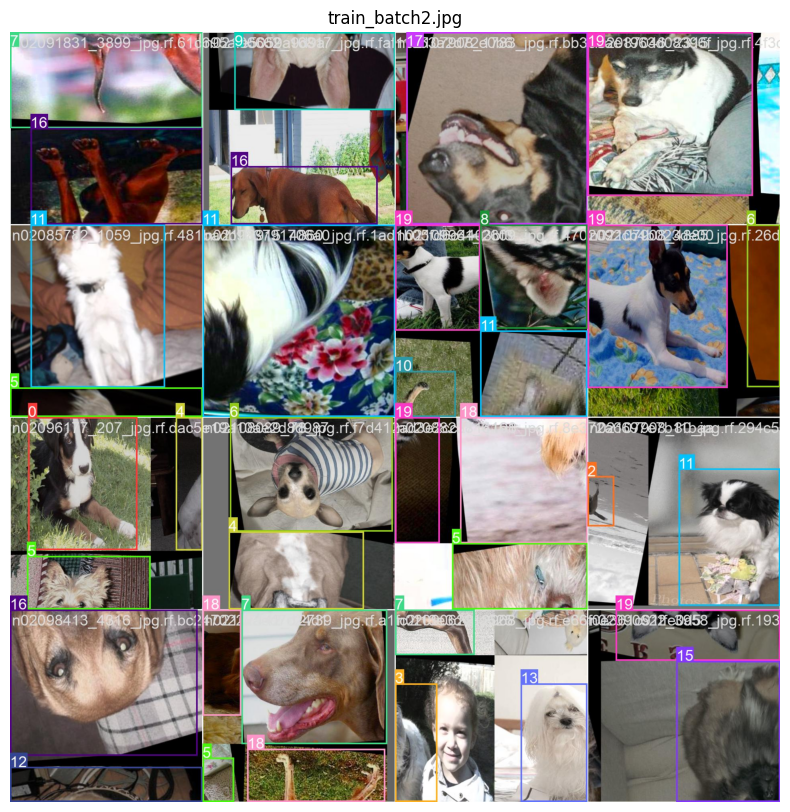

In [6]:
import os
import random
import cv2
import matplotlib.pyplot as plt
from IPython.display import display, Image

# Define paths
results_path = '/content/yolov5/runs/train/exp'
image_files = [f for f in os.listdir(results_path) if f.endswith('.jpg') or f.endswith('.png')]

# Select ten random images
random_images = random.sample(image_files, 10)

# Display images with annotations
for img_file in random_images:
    img_path = os.path.join(results_path, img_file)
    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(10, 10))
    plt.imshow(img_rgb)
    plt.axis('off')
    plt.title(img_file)
    plt.show()


In [7]:
!python /content/yolov5/detect.py --weights /content/yolov5/runs/train/exp/weights/best.pt --img-size 640 --conf 0.3 --source /content/Dog-Breeds-1/test/images



detect: weights=['/content/yolov5/runs/train/exp/weights/best.pt'], source=/content/Dog-Breeds-1/test/images, data=yolov5/data/coco128.yaml, imgsz=[640, 640], conf_thres=0.3, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_format=0, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=yolov5/runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-366-gf7322921 Python-3.10.12 torch-2.4.0+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7064065 parameters, 0 gradients, 15.9 GFLOPs
image 1/225 /content/Dog-Breeds-1/test/images/n02085620_1502_jpg.rf.14c50ad5defa239219727bac27573c79.jpg: 640x640 (no detections), 11.7ms
image 2/225 /content/Dog-Breeds-1/test/images/n02085620_1816_jpg.rf.a9fbd95a3284ef55ec0e36f6a798506b.jpg: 640x640 (no detections), 11

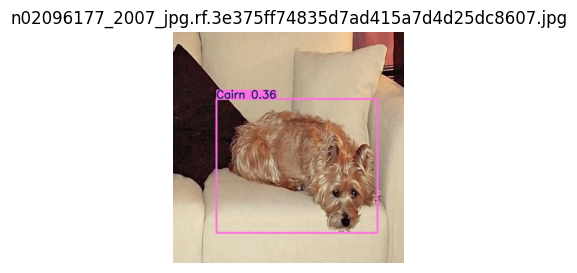

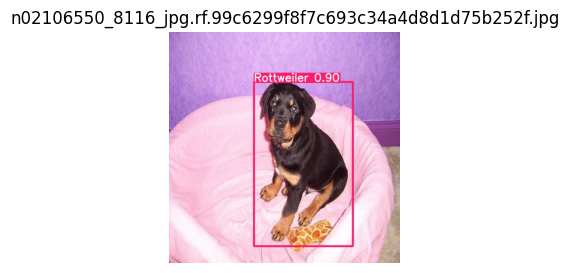

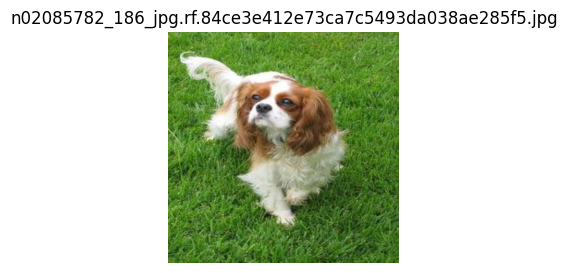

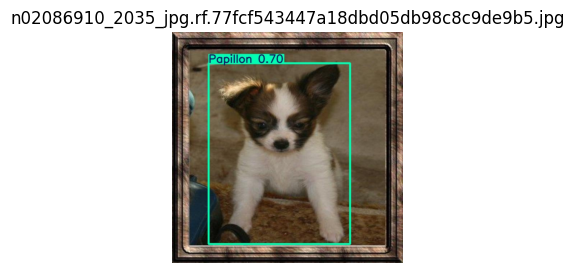

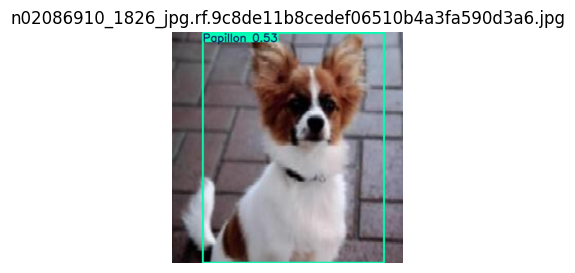

...

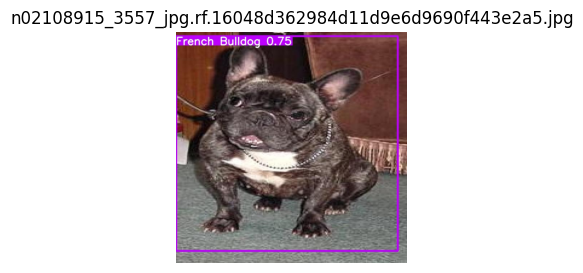

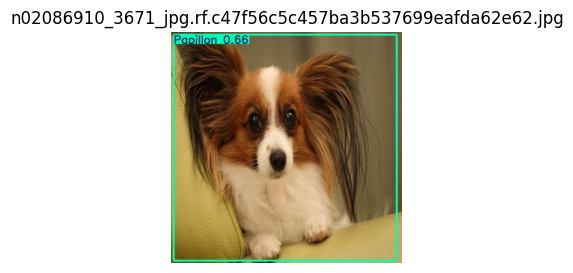

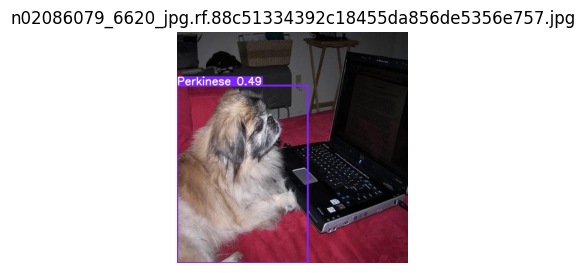

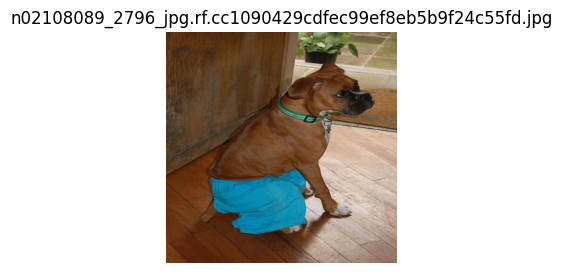

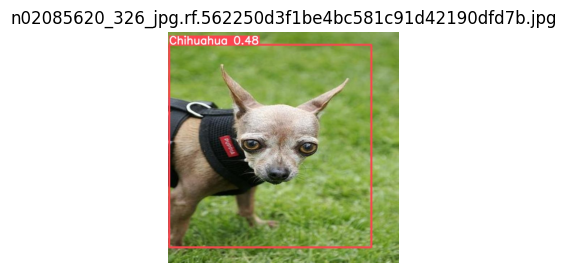

In [9]:
import os
import random
import cv2
import matplotlib.pyplot as plt
from IPython.display import display, Image

# Define paths
results_path = '/content/yolov5/runs/detect/exp'
image_files = [f for f in os.listdir(results_path) if f.endswith('.jpg') or f.endswith('.png')]

# Select ten random images
random_images = random.sample(image_files, 20)

# Display images with annotations
for img_file in random_images:
    img_path = os.path.join(results_path, img_file)
    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(3, 3))
    plt.imshow(img_rgb)
    plt.axis('off')
    plt.title(img_file)
    plt.show()
